In [29]:
import pandas as pd
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
#from ydata_profiling import ProfileReport #incredible library for fast/simple data reporting
# First part will involve explore the data set available to me for the Master Thesis topic:
# Algorithmic Venture insights (exploring ML in VC)
# I acknowledge the limited scope of the application of ML 1) due to limited dataset (outdated)
# 2) scope of the practical application - focused on patterns "features" (i.e. other studies
# tried enriching their dataset with LinkedIN, Twitter and other data; there are classification,
# as well as regression tasks involving startups/VC and Machine learning - more on that in
# the literature review of the thesis)

# Loading data and initial inspection

In [30]:
# Loading the datasets (acquisitions, investments, rounds, companies)
acquisitions = pd.read_csv('/Users/Tom/Library/Mobile Documents/com~apple~CloudDocs/Uni Wien/Thesis/Other/acquisitions.csv')
investments = pd.read_csv('/Users/Tom/Library/Mobile Documents/com~apple~CloudDocs/Uni Wien/Thesis/Other/investments.csv')
rounds = pd.read_csv('/Users/Tom/Library/Mobile Documents/com~apple~CloudDocs/Uni Wien/Thesis/Other/rounds.csv')
companies = pd.read_csv('/Users/Tom/Library/Mobile Documents/com~apple~CloudDocs/Uni Wien/Thesis/Other/companies.csv')

In [31]:
# Understanding each dataset

print("Acquisitions info: ", acquisitions.info())
print("Investments info: ", investments.info())
print("Rounds info: ", rounds.info())
print("Companies info: ", companies.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18968 entries, 0 to 18967
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   company_permalink       18968 non-null  object 
 1   company_name            18968 non-null  object 
 2   company_category_list   13985 non-null  object 
 3   company_country_code    14300 non-null  object 
 4   company_state_code      14020 non-null  object 
 5   company_region          14058 non-null  object 
 6   company_city            14058 non-null  object 
 7   acquirer_permalink      18968 non-null  object 
 8   acquirer_name           18968 non-null  object 
 9   acquirer_category_list  16580 non-null  object 
 10  acquirer_country_code   17798 non-null  object 
 11  acquirer_state_code     17533 non-null  object 
 12  acquirer_region         17609 non-null  object 
 13  acquirer_city           17609 non-null  object 
 14  acquired_at             18956 non-null

In [32]:
# Companies dataset represents the core dataset, which will presumably be enriched by (merged with)
# other datasets to create a clean dataset for the ML part
# Not all columns contain relevant data, but those that do need to be handled for missing data
companies.isnull().sum(axis = 0)

permalink                0
name                     1
homepage_url          5058
category_list         3148
funding_total_usd        0
status                   0
country_code          6958
state_code            8547
region                8030
city                  8028
funding_rounds           0
founded_at           15221
first_funding_at        24
last_funding_at          0
dtype: int64

In [33]:
# funding_total, status, first_funding_at (perhaps also founded_at), funding_rounds, last_funding_at
# are neccessary for the feature engineering part of this project --> NaN dropped
companies = companies.dropna(subset=['first_funding_at'])
companies.isnull().sum(axis = 0) #check

permalink                0
name                     1
homepage_url          5058
category_list         3147
funding_total_usd        0
status                   0
country_code          6956
state_code            8545
region                8028
city                  8026
funding_rounds           0
founded_at           15218
first_funding_at         0
last_funding_at          0
dtype: int64

In [34]:
#['homepage_url'] does not give us a lot, though if we were working with current data about
#companies, the column would be
#more valuable as we could use 'requests' | urllib and check if the company has an active page and 
#potentially scrape additional data from that page
# import requests
# from requests.exceptions import RequestException

# def is_url_active(url):
#     try:
#         response = requests.head(url, allow_redirects=True, timeout=5)
#         return response.status_code in range(200, 299)
#     except RequestException:
#         return False

#df['url_active'] = df['urls'].apply(is_url_active)

companies = companies.drop('homepage_url', axis =1)
companies.columns

Index(['permalink', 'name', 'category_list', 'funding_total_usd', 'status',
       'country_code', 'state_code', 'region', 'city', 'funding_rounds',
       'founded_at', 'first_funding_at', 'last_funding_at'],
      dtype='object')

In [35]:
companies[companies['name'].isnull()] #no need to drop, since it can be merged on 'permalink'

,permalink,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at
56916,/organization/tell-it-in,NaN,Startups,25000,closed,USA,OR,"Portland, Oregon",Portland,1,2011-10-01,2012-03-01,2012-03-01


In [36]:
rounds['company_country_code'].value_counts()

company_country_code
USA    72308
GBR     5966
CAN     3115
CHN     2693
IND     2233
       ...  
KNA        1
BRN        1
DZA        1
TGO        1
GGY        1
Name: count, Length: 137, dtype: int64

In [37]:
# As we have data for Acquisitions and not for IPO, do we suppose that 
# the 'last_funding_at' is IPO date? Meaning, how long did it take the 
# company to go public.
companies[companies['status'] == 'ipo']

,permalink,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at
139,/organization/21vianet,21viaNet,Software|Web Hosting,396000000,ipo,CHN,22,Beijing,Beijing,5,2009-10-16,2008-02-13,2014-12-04
140,/organization/22nd-century-group,22nd Century Group,Biotechnology,15034750,ipo,USA,NY,NY - Other,Clarence,6,1998-01-01,2010-12-28,2014-09-18
201,/organization/2u,2U Inc.,EdTech|Education|Software,95875000,ipo,USA,MD,MD - Other,Hyattsville,6,2008-01-01,2009-03-25,2013-10-21
270,/organization/3d-systems,3D Systems,Software,169500000,ipo,USA,SC,SC - Other,Rock Hill,3,1986-01-01,2014-01-15,2014-10-13
436,/organization/58-com,58.com,Curated Web|Internet|Software,876780000,ipo,CHN,19,CHN - Other,Chaoyang,6,2005-01-01,2006-02-01,2014-06-27
...,...,...,...,...,...,...,...,...,...,...,...,...,...
66215,/organization/zoopla,Zoopla,Property Management|Real Estate,13387373.8236279,ipo,GBR,H9,London,London,3,2007-06-01,2007-01-01,2010-12-23
66216,/organization/zooplus,Zooplus,Pets|Trading,-,ipo,DEU,2,Muenchen,Muenchen,1,1999-01-01,2000-01-01,2000-01-01
66235,/organization/zosano-pharma,Zosano Pharma,Biotechnology,158688887,ipo,USA,CA,SF Bay Area,Fremont,9,2006-10-01,2007-11-15,2015-02-03
66350,/organization/zynerba-pharmaceuticals,Zynerba Pharmaceuticals,Pharmaceuticals,13000000,ipo,USA,PA,Philadelphia,Radnor,1,2014-01-01,2014-10-14,2014-10-14


In [38]:
# inspecting the 'first_funding_at', first trial showed some dates that
# fall out of bounds for pd.to_datetime
# errors = 'coerce' renders invalid dates to NaT
# Doing the same for last_funding_at as both columns will be used for a
# feature ['time_since_funding']
companies['first_funding_at'] = pd.to_datetime(companies['first_funding_at'], errors='coerce')
companies['first_funding_at'].isna().sum()

3

In [39]:
companies['last_funding_at'] = pd.to_datetime(companies['last_funding_at'], errors='coerce')
companies['last_funding_at'].isna().sum()

0

In [40]:
companies['founded_at'] = pd.to_datetime(companies['founded_at'], errors='coerce')
companies['founded_at'].isna().sum()

15222

### Dummy Variable for handling missing data (founded_at)

In [41]:
# Creating a new column 'founded_at_missing' to indicate missing values in 'founded_at'
companies['founded_at_missing'] = companies['founded_at'].isna().astype(int)

In [42]:
companies[['founded_at', 'founded_at_missing']].head(10)

,founded_at,founded_at_missing
0,NaT,1
1,2014-09-04,0
2,NaT,1
3,2007-01-01,0
4,2010-01-01,0
5,NaT,1
6,1997-01-01,0
7,2011-01-01,0
8,2011-08-01,0
9,2012-01-01,0


In [43]:
# Count the number of companies founded in each year
year_counts = companies['founded_at'].dt.year.value_counts().sort_index()
year_counts


founded_at
1749.0       1
1766.0       1
1785.0       1
1787.0       1
1789.0       1
          ... 
2015.0    1575
2016.0       2
2041.0       1
2104.0       1
2105.0       1
Name: count, Length: 176, dtype: int64

In [44]:
print(companies['founded_at'].min())
print(companies['founded_at'].max())

1749-01-01 00:00:00
2105-02-17 00:00:00


In [45]:
# Since some of the founding dates make no sense, I decided to reduce
# the time window into years 1998-2015 (included)
# BUT CAREFUL NOT TO DROP DUMMY VARIABLES 0, WHILE CONDITION NEEDED

# Filter companies with a known 'founded_at' date between 1998 and 2015, or with 'founded_at' missing
companies = companies[((companies['founded_at'].dt.year >= 1998) & (companies['founded_at'].dt.year <= 2015)) | (companies['founded_at_missing'] == 1)]

print(companies['founded_at'].min())
print(companies['founded_at'].max())

1998-01-01 00:00:00
2015-12-23 00:00:00


In [46]:
# Additional dropping needs to take place for 'operating' companies
# for company['status'] == operating, the cutoff founded_at date will be
# 2013 (included) - the startup has 2 years to show signs of success.

In [47]:
# Exclude 'operating' companies founded after 2013
companies = companies[~((companies['status'] == 'operating') & (companies['founded_at'].dt.year > 2013))  | (companies['founded_at_missing'] == 1)]

### Operating time for active companies

In [48]:
# Filter the DataFrame
operating_companies = companies[(companies['status'] == 'operating') & (companies['founded_at_missing'] == 0)]
operating_companies.head(5)

,permalink,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at,founded_at_missing
3,/organization/0-6-com,0-6.com,Curated Web,2000000,operating,CHN,22,Beijing,Beijing,1,2007-01-01,2008-03-19,2008-03-19,0
4,/organization/004-technologies,004 Technologies,Software,-,operating,USA,IL,"Springfield, Illinois",Champaign,1,2010-01-01,2014-07-24,2014-07-24,0
7,/organization/0xdata,H2O.ai,Analytics,33600000,operating,USA,CA,SF Bay Area,Mountain View,4,2011-01-01,2013-01-03,2015-11-09,0
8,/organization/1,One Inc.,Mobile,1150050,operating,USA,CA,SF Bay Area,San Francisco,3,2011-08-01,2011-07-20,2014-02-05,0
9,/organization/1-2-3-listo,"1,2,3 Listo",E-Commerce,40000,operating,CHL,12,Santiago,Las Condes,1,2012-01-01,2013-02-18,2013-02-18,0


In [49]:
# Define the end date
end_date = pd.to_datetime('2015-12-31')

# Function to calculate operating time
def calculate_operating_time(row):
    if row['status'] == 'operating' and row['founded_at_missing'] == 0:
        return (end_date - row['founded_at']).days / 365
    else:
        return 'not available'

# Apply the function to create the 'operating_time' column
companies['operating_time'] = companies.apply(calculate_operating_time, axis=1)

In [50]:
companies[companies['operating_time'] != 'not available']

,permalink,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at,founded_at_missing,operating_time
3,/organization/0-6-com,0-6.com,Curated Web,2000000,operating,CHN,22,Beijing,Beijing,1,2007-01-01,2008-03-19,2008-03-19,0,9.00274
4,/organization/004-technologies,004 Technologies,Software,-,operating,USA,IL,"Springfield, Illinois",Champaign,1,2010-01-01,2014-07-24,2014-07-24,0,6.0
7,/organization/0xdata,H2O.ai,Analytics,33600000,operating,USA,CA,SF Bay Area,Mountain View,4,2011-01-01,2013-01-03,2015-11-09,0,5.0
8,/organization/1,One Inc.,Mobile,1150050,operating,USA,CA,SF Bay Area,San Francisco,3,2011-08-01,2011-07-20,2014-02-05,0,4.419178
9,/organization/1-2-3-listo,"1,2,3 Listo",E-Commerce,40000,operating,CHL,12,Santiago,Las Condes,1,2012-01-01,2013-02-18,2013-02-18,0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66356,/organization/zype,Zype,Cloud Computing|Mobile Advertising|Video|Video...,3300000,operating,USA,NY,New York City,New York,2,2013-01-01,2015-04-01,2015-10-27,0,2.99726
66357,/organization/zypsee,Whisk (formerly Zypsee),Public Transportation,2150000,operating,USA,NY,New York City,New York,2,2011-01-01,2013-07-26,2013-09-25,0,5.0
66361,/organization/zytoprotec,Zytoprotec,Biotechnology,2686600,operating,AUT,3,Vienna,Gerasdorf Bei Wien,1,2007-01-01,2013-01-29,2013-01-29,0,9.00274
66364,/organization/zzzzapp-com,Zzzzapp Wireless ltd.,Advertising|Mobile|Web Development|Wireless,114304,operating,HRV,15,Split,Split,4,2012-05-13,2011-11-01,2014-03-01,0,3.635616


In [86]:
companies.info()

<class 'pandas.core.frame.DataFrame'>
Index: 57202 entries, 0 to 66367
Data columns (total 18 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   permalink                  57202 non-null  object        
 1   name                       57201 non-null  object        
 2   category_list              57202 non-null  object        
 3   funding_total_usd          57202 non-null  float64       
 4   status                     57202 non-null  object        
 5   country_code               51146 non-null  object        
 6   state_code                 49779 non-null  object        
 7   region                     50216 non-null  object        
 8   city                       50218 non-null  object        
 9   funding_rounds             57202 non-null  int64         
 10  founded_at                 41980 non-null  datetime64[ns]
 11  first_funding_at           57199 non-null  datetime64[ns]
 12  last_fund

In [52]:
companies['funding_total_usd'] = pd.to_numeric(companies['funding_total_usd'], errors='coerce')
companies['funding_total_usd'].isna().sum()

10572

### Dummy Variable for handling missing data (funding_total_usd)

In [53]:
# Creating a new column 'funding_total_usd_missing' to indicate missing values
companies['funding_total_usd_missing'] = companies['funding_total_usd'].isna().astype(int)

In [54]:
# Replacing missing values in 'funding_total_usd' with 0
companies['funding_total_usd'].fillna(0, inplace=True)

In [55]:
# Checking the first few rows of the DataFrame to verify the changes
companies[['funding_total_usd', 'funding_total_usd_missing']].head()


,funding_total_usd,funding_total_usd_missing
0,10000000.0,0
2,3406878.0,0
3,2000000.0,0
4,0.0,1
5,41250.0,0


In [56]:
#comp_report = ProfileReport(companies, title="Companies Report")
#comp_report

### (above section) This should conlude the basic EDA and preprocessing of companies data

# Geography-based dataset (# not needed now)

In [57]:
# GEOGRAPHY - hypothesis: US startup companies may prevail with number of IPOs compared to 
# rest of the world, since the US market has a stronger IPO market --> therefore separating the
# dataset into US and ROW may be useful for further inspection
# Furthermore, US companies are oversampled in the total dataset of companies

#pd.set_option('display.max_rows', None)

#print(companies['country_code'].value_counts())


country_code
USA    32267
GBR     3215
CAN     1648
CHN     1434
IND     1244
FRA     1018
DEU      917
ISR      819
ESP      676
RUS      429
AUS      426
NLD      421
SWE      403
SGP      391
IRL      389
BRA      378
JPN      370
ITA      346
KOR      324
CHL      306
CHE      296
DNK      274
FIN      245
BEL      179
ARG      174
HKG      168
TUR      154
POL      134
NOR      117
AUT      117
MEX      116
PRT       98
NZL       92
ZAF       80
IDN       79
BGR       78
ARE       74
EST       68
CZE       63
MYS       61
COL       53
THA       51
UKR       50
PHL       49
TWN       46
HUN       45
NGA       41
LTU       39
PER       38
VNM       36
LVA       35
KEN       34
GRC       32
ROM       31
EGY       30
JOR       29
PAK       28
LUX       28
SVK       22
LBN       21
SVN       19
CYP       18
ISL       18
UGA       14
GHA       13
SRB       13
VEN       12
CYM       12
URY       12
TAN        9
SAU        8
KHM        8
CRI        8
HRV        8
BGD        8
PAN        7

In [58]:
# = companies[companies['country_code'] == 'USA']
#us_comp.head()

,permalink,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at,founded_at_missing,operating_time,funding_total_usd_missing
4,/organization/004-technologies,004 Technologies,Software,0.0,operating,USA,IL,"Springfield, Illinois",Champaign,1,2010-01-01,2014-07-24,2014-07-24,0,6.0,1
7,/organization/0xdata,H2O.ai,Analytics,33600000.0,operating,USA,CA,SF Bay Area,Mountain View,4,2011-01-01,2013-01-03,2015-11-09,0,5.0,0
8,/organization/1,One Inc.,Mobile,1150050.0,operating,USA,CA,SF Bay Area,San Francisco,3,2011-08-01,2011-07-20,2014-02-05,0,4.419178,0
10,/organization/1-4-all,1-4 All,Entertainment|Games|Software,0.0,operating,USA,NC,NC - Other,Connellys Springs,1,NaT,2013-04-21,2013-04-21,1,not available,1
11,/organization/1-618-technology,1.618 Technology,Networking|Real Estate|Web Hosting,0.0,operating,USA,FL,Orlando,Orlando,1,2013-12-07,2014-01-22,2014-01-22,0,2.065753,1


In [59]:
#us_comp['country_code'].value_counts()

country_code
USA    32267
Name: count, dtype: int64

In [60]:
#ChatGPT generated list of EU states
#eu_country_codes = ['AUT', 'BEL', 'BGR', 'HRV', 'CYP', 'CZE', 'DNK', 'EST', 'FIN', 'FRA', 
                    'DEU', 'GRC', 'HUN', 'IRL', 'ITA', 'LVA', 'LTU', 'LUX', 'MLT', 'NLD', 
                    'POL', 'PRT', 'ROU', 'SVK', 'SVN', 'ESP', 'SWE']
#eu_comp = companies[companies['country_code'].isin(eu_country_codes)]
#eu_comp['country_code'].value_counts()

country_code
FRA    1018
DEU     917
ESP     676
NLD     421
SWE     403
IRL     389
ITA     346
DNK     274
FIN     245
BEL     179
POL     134
AUT     117
PRT      98
BGR      78
EST      68
CZE      63
HUN      45
LTU      39
LVA      35
GRC      32
LUX      28
SVK      22
SVN      19
CYP      18
HRV       8
MLT       6
Name: count, dtype: int64

In [61]:
#row_comp = rest_of_world_companies = companies[~companies['country_code'].isin(eu_country_codes + ['USA'])]
#row_comp['country_code'].value_counts()

country_code
GBR    3215
CAN    1648
CHN    1434
IND    1244
ISR     819
RUS     429
AUS     426
SGP     391
BRA     378
JPN     370
KOR     324
CHL     306
CHE     296
ARG     174
HKG     168
TUR     154
NOR     117
MEX     116
NZL      92
ZAF      80
IDN      79
ARE      74
MYS      61
COL      53
THA      51
UKR      50
PHL      49
TWN      46
NGA      41
PER      38
VNM      36
KEN      34
ROM      31
EGY      30
JOR      29
PAK      28
LBN      21
ISL      18
UGA      14
GHA      13
SRB      13
VEN      12
CYM      12
URY      12
TAN       9
SAU       8
BGD       8
CRI       8
KHM       8
PAN       7
MUS       7
ECU       6
BHR       5
TTO       5
BMU       5
GTM       5
BWA       4
NPL       4
AZE       4
DOM       3
TUN       3
MMR       3
LAO       3
MKD       3
JAM       3
SLV       3
MDA       3
BLR       3
CMR       3
LKA       3
ZWE       3
BLZ       2
GEO       2
KWT       2
CIV       2
MOZ       2
LIE       2
RWA       2
MAR       2
PRI       2
ZMB       2
PSE       2
NIC

In [62]:
# print(f"US companies shape: {us_comp.shape}")
# print(f"EU companies shape: {eu_comp.shape}")
# print(f"ROW companies shape: {row_comp.shape}")

US companies shape: (32267, 16)
EU companies shape: (5678, 16)
ROW companies shape: (19257, 16)


### What does a Profile Report say about each geographical dataset

In [63]:
# from ydata_profiling import ProfileReport, compare
# # This library enables me to generate professional reports out of dataframes, the form seems
# # suitable for inclusion in the practical part of the thesis

In [64]:
# # us_profile = ProfileReport(us_comp, title="American Report")
# eu_profile = ProfileReport(eu_comp, title="EU Report")
# row_profile = ProfileReport(row_comp, title="Rest of the world Report")

In [65]:
#us_profile

In [66]:
#eu_profile

In [67]:
#row_profile

In [68]:
# comparison_report = compare([us_profile, eu_profile, row_profile])
# comparison_report

# Categories

In [69]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet

nltk.download('wordnet')
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package wordnet to /Users/Tom/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /Users/Tom/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/Tom/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [70]:
# # I want to have a group of 20 unique industries that encompass all value names of the category list
# column of each dataset to. I will aim to create a new column 'Industry' that clusters the values
# of the 'category_list' and serves as a feature in the later stage of this project. For the feature
# engineering part, I will use the default column 'category_list' as subcategory.

In [71]:
# Is this step fine or should we code a dummy variable for missing category
companies['category_list'].fillna('Unknown', inplace=True)

In [77]:
companies[companies['category_list'] == 'Unknown'][['category_list','clean_category']].head()

,category_list,clean_category
71,Unknown,[unknown]
113,Unknown,[unknown]
122,Unknown,[unknown]
154,Unknown,[unknown]
160,Unknown,[unknown]


### Tokenization

In [84]:
def process_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    # 
    tokens = [token.lower() for token in tokens]
    # Keeping tokens with hyphens or alphanumeric characters, and removing stopwords except 'other'
    tokens = [token for token in tokens if '-' in token or token.isalpha()]
    tokens = [token for token in tokens if token not in stopwords.words('english') or token == 'unknown']
    return tokens

# Apply text processing to the 'category_list' column
companies['clean_category'] = companies['category_list'].apply(lambda x: process_text(x.replace('|', ' ')))


In [74]:
from collections import Counter

# Flatten the list of lists in 'tokens' column and count occurrences
all_tokens = [token for sublist in companies['clean_category'] for token in sublist]
token_counts = Counter(all_tokens)

# Convert to DataFrame for easy handling
token_counts_df = pd.DataFrame(token_counts.items(), columns=['clean_category', 'Count']).sort_values(by='Count', ascending=False)
print(token_counts_df.head(25))  # Display top 25 tokens


    clean_category  Count
6         software  11898
3           mobile   6563
0            media   5090
34          social   5008
46          health   4765
5              web   4622
44      technology   4368
43   biotechnology   4127
8       e-commerce   3799
59        services   3496
4          curated   2907
30     advertising   2797
2            games   2704
85         unknown   2648
14        internet   2633
36      enterprise   2608
114           care   2414
7        analytics   2353
15       marketing   2289
82         finance   1926
77            data   1903
20       education   1843
62            saas   1712
186     management   1709
47        wellness   1704


In [75]:
top_industry = token_counts_df['clean_category'].head(25).tolist()

# unknown will be removed from the list --> it will be later assigned a
# value 'other' 
top_industry.remove('unknown')
# List of additional categories to append
additional_categories = ['manufacturing', 'security', 'travel', 'semiconductors', 'real', 'estate']

# Append additional categories to top_industry list
top_industry.extend(additional_categories)
top_industry

['software',
 'mobile',
 'media',
 'social',
 'health',
 'web',
 'technology',
 'biotechnology',
 'e-commerce',
 'services',
 'curated',
 'advertising',
 'games',
 'internet',
 'enterprise',
 'care',
 'analytics',
 'marketing',
 'finance',
 'data',
 'education',
 'saas',
 'management',
 'wellness',
 'manufacturing',
 'security',
 'travel',
 'semiconductors',
 'real',
 'estate']

In [85]:
def category_filter(categories_list):
    for industry in top_industry:
        if industry in categories_list:
            return industry
    return 'other'

# Apply the function to the DataFrame
companies['single_category'] = companies['clean_category'].apply(category_filter)
companies[['category_list', 'clean_category', 'single_category']]

,category_list,clean_category,single_category
0,Media,[media],media
2,Apps|Games|Mobile,"[apps, games, mobile]",mobile
3,Curated Web,"[curated, web]",web
4,Software,[software],software
5,Games,[games],games
7,Analytics,[analytics],analytics
8,Mobile,[mobile],mobile
9,E-Commerce,[e-commerce],e-commerce
10,Entertainment|Games|Software,"[entertainment, games, software]",software
11,Networking|Real Estate|Web Hosting,"[networking, real, estate, web, hosting]",web


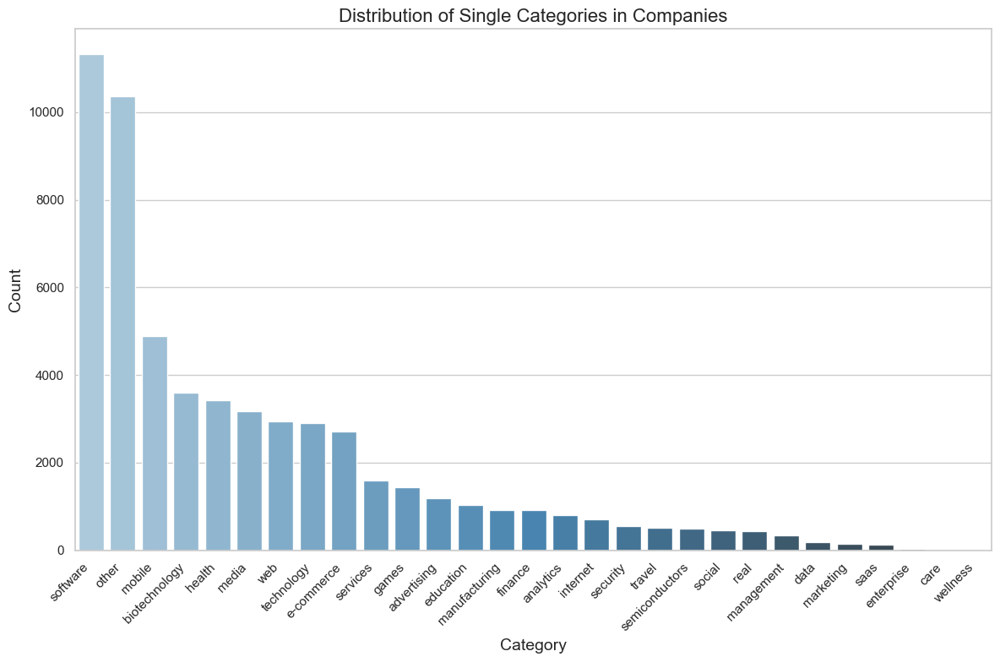

In [83]:
# Count the occurrences of each category
category_counts = companies['single_category'].value_counts()

# Setting the plot style
sns.set(style="whitegrid")

# Create a bar plot
plt.figure(figsize=(12, 8))
barplot = sns.barplot(x=category_counts.index, y=category_counts.values, palette="Blues_d")

# Rotate x labels for better readability
plt.xticks(rotation=45, ha='right')

# Setting title and labels
plt.title('Distribution of Single Categories in Companies', fontsize=16)
plt.xlabel('Category', fontsize=14)
plt.ylabel('Count', fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

In [88]:
companies.to_csv('clean_companies.csv', index = False)